# Data Analysis 

In [1]:
#import libraries
import numpy as np
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns
sns.set_style("darkgrid")
sns.set_palette("Blues_r")

In [2]:
#importing dataset
files_dir = "dataset/"
filename = files_dir + "AB_NYC_2019.csv"
df = pd.read_csv(filename)

FileNotFoundError: [Errno 2] No such file or directory: 'dataset/AB_NYC_2019.csv'

## Data Inspection

In [ ]:
df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [ ]:
print(f'There are {df.shape[0]} rows in the dataset and {df.shape[1]} columns')

There are 48895 rows in the dataset and 16 columns


## Data Analysis and Feature Engineering

### Data Types

In [ ]:
for col in df.columns:
  if df[col].dtype == 'object':
    print(f'{col} is of type categorical')

name is of type categorical
host_name is of type categorical
neighbourhood_group is of type categorical
neighbourhood is of type categorical
room_type is of type categorical
last_review is of type categorical


Last review should not be categorial, it must be a date type so we would need to change it.

In [3]:
df['last_review'] = pd.to_datetime(df['last_review'])

NameError: name 'df' is not defined

In [4]:
df['last_review']

NameError: name 'df' is not defined

In [164]:
for col in df.columns:
  if df[col].dtype in ('int64','float'):
    print(f'{col} is numeric')

id is numeric
host_id is numeric
latitude is numeric
longitude is numeric
price is numeric
minimum_nights is numeric
number_of_reviews is numeric
reviews_per_month is numeric
calculated_host_listings_count is numeric
availability_365 is numeric


We can see that eventhough id and host_id are numers, they must be categoricals as the magnitude does not give us information regarding the order. 



In [165]:
for _ in ['id','host_id']:
  df[_] = df[_].astype('object')

Since  host_name and host_id are columns that give information regarding the  host we can drop them from the dataset. This data could be unethical to use for our analysis. 

In [166]:
df.drop(['host_id','host_name'], axis=1, inplace=True)

In addition, latitude and longitude do not represent a numeric data, this is a geospatial data that could be used to obtain more information in regards to the location. 

### Issues in the dataset

In [167]:
#check for missing values in the dataset
(df.isna().sum())/(df.count())

id                                0.000000
name                              0.000327
neighbourhood_group               0.000000
neighbourhood                     0.000000
latitude                          0.000000
longitude                         0.000000
room_type                         0.000000
price                             0.000000
minimum_nights                    0.000000
number_of_reviews                 0.000000
last_review                       0.258785
reviews_per_month                 0.258785
calculated_host_listings_count    0.000000
availability_365                  0.000000
dtype: float64

We can make an assumption here, that those listing that have NaN for review per month and NaN for last_review have 0 reviews. 


In [168]:
df[(df.last_review.isnull()) & (df.reviews_per_month.isnull())] = df[(df.last_review.isnull()) & (df.reviews_per_month.isnull())].replace(np.nan,0)

As we do not have information regarding the rest of the reviews, only the last review, we consider this feature is irrelevant and drop it. 

In [169]:
df.drop(['last_review'], axis=1, inplace=True)

In [170]:
(df.isna().sum())/(df.count())

id                                0.000000
name                              0.000123
neighbourhood_group               0.000000
neighbourhood                     0.000000
latitude                          0.000000
longitude                         0.000000
room_type                         0.000000
price                             0.000000
minimum_nights                    0.000000
number_of_reviews                 0.000000
reviews_per_month                 0.000000
calculated_host_listings_count    0.000000
availability_365                  0.000000
dtype: float64

There are still some missing values in the dataset, that have to do with the name of the lisitng. For now, we want to keep this feature as we would like to explore using NLP to get some key words that could be used for the prediction. Given this and given that those that are missing are less than 1%, we will drop those rows with NaN in name. 

In [171]:
df.dropna(subset = ['name'], inplace= True)

In [172]:
(df.isna().sum())/(df.count())

id                                0.0
name                              0.0
neighbourhood_group               0.0
neighbourhood                     0.0
latitude                          0.0
longitude                         0.0
room_type                         0.0
price                             0.0
minimum_nights                    0.0
number_of_reviews                 0.0
reviews_per_month                 0.0
calculated_host_listings_count    0.0
availability_365                  0.0
dtype: float64

In [173]:
#check for duplicated data in the dataset
df.duplicated().sum()

0

In [174]:
# check for misalignment of values and columns
df.describe()

,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,48889.000000,48889.000000,48889.000000,48889.000000,48889.000000,48889.000000,48889.000000,48889.000000
mean,40.728950,-73.952168,152.719180,7.030416,23.276443,1.091025,7.144736,112.780789
std,0.054532,0.046158,240.167837,20.511755,44.552835,1.597346,32.954471,131.617539
min,40.499790,-74.244420,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
25%,40.690100,-73.983070,69.000000,1.000000,1.000000,0.040000,1.000000,0.000000
50%,40.723070,-73.955680,106.000000,3.000000,5.000000,0.370000,1.000000,45.000000
75%,40.763120,-73.936280,175.000000,5.000000,24.000000,1.580000,2.000000,227.000000
max,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [175]:
df.neighbourhood_group.unique()

array(['Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Bronx'],
      dtype=object)

In [176]:
df.room_type.unique()

array(['Private room', 'Entire home/apt', 'Shared room'], dtype=object)

In [177]:
df.columns

Index(['id', 'name', 'neighbourhood_group', 'neighbourhood', 'latitude',
       'longitude', 'room_type', 'price', 'minimum_nights',
       'number_of_reviews', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365'],
      dtype='object')

In [178]:
numeric_features =  ["price","minimum_nights","number_of_reviews","reviews_per_month","calculated_host_listings_count","availability_365"]
categorical_features = ['id','name','neighbourhood_group', 'neighbourhood', 'room_type']

In [179]:
len(numeric_features) + len(categorical_features)


11

In [180]:
df.shape[1]

13

### Univariate and bivariate analysis

In [181]:

import seaborn as sns
def hist_box_plot(df, col):
	sns.set(style="darkgrid")
	f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.15, .85)})
	sns.boxplot(df[col], ax=ax_box)
	sns.histplot(data=df[col], ax=ax_hist)
	ax_box.set(xlabel='')
	return plt.show()

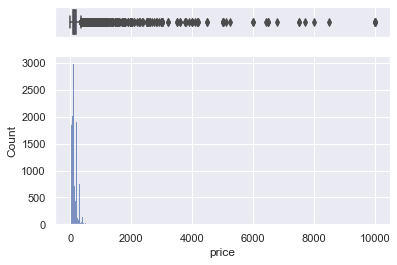

In [182]:
hist_box_plot(df, 'price')

To remove the skeweness of the price(target), we will use log transformation.

In [183]:
df['price'].min()

0

Since we have values with 0, we will add a one to the input array. 

In [184]:
price_data = df['price'].copy()
price_data_log = np.log1p(price_data)

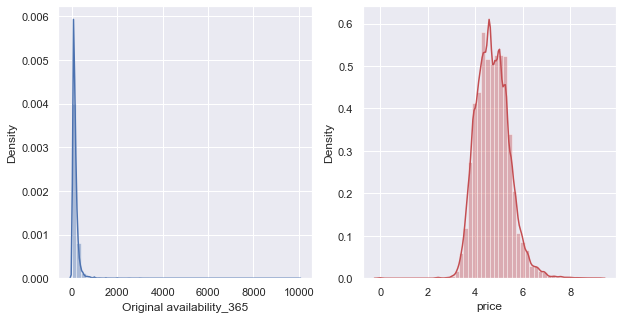

In [185]:
fig, axes = plt.subplots(1, 2, figsize=(10, 5))
ax1 = sns.distplot(price_data, ax=axes[0])
ax1.set(xlabel='Original ' + col)
sns.set_palette("Paired")
ax2 = sns.distplot(price_data_log, ax=axes[1], color = 'r')

In [186]:
categorical_features

['id', 'name', 'neighbourhood_group', 'neighbourhood', 'room_type']

In [187]:
#outliers detection
for i in  numeric_features[1:]:
	fig = px.box(df[i])
	fig.show()

In [188]:
#to handle outliers we could use winsorization to remove very extreme values. 

In [189]:
from scipy.stats.mstats import winsorize
df_win = df.copy(deep=True)
df_win['minimum_nights'] = winsorize(df['minimum_nights'], limits=(0, 0.075))
df_win['number_of_reviews'] = winsorize(df['number_of_reviews'], limits=(0, 0.075))
df_win['reviews_per_month'] = winsorize(df['reviews_per_month'], limits=(0, 0.075))
df_win['calculated_host_listings'] = winsorize(df['calculated_host_listings_count'], limits=(0, 0.075))
df_win['availability_365'] = winsorize(df['availability_365'], limits=(0, 0.075))


In [190]:
for i in  numeric_features[1:]:
	fig = px.box(df_win[i])
	fig.show()

In [191]:
df_new = df_win.copy(deep=True)

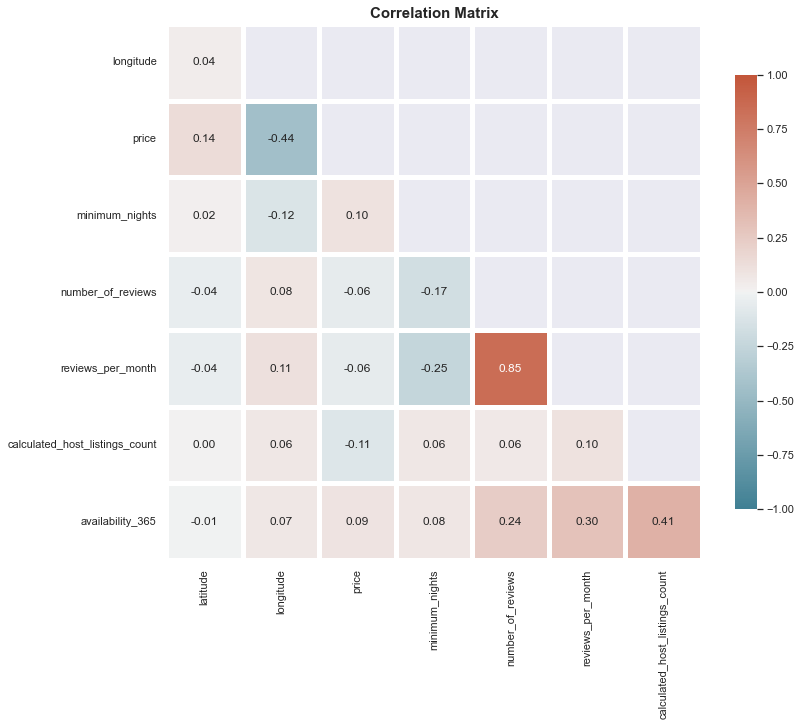

In [192]:

corr_cinc = df.corr('spearman')
fig, ax = plt.subplots(figsize=(12, 10))
mask = np.triu(np.ones_like(corr_cinc, dtype=np.bool))# adjust mask and df
mask = mask[1:, :-1]
corr = corr_cinc.iloc[1:,:-1].copy()# color map
cmap = sns.diverging_palette(220, 20, as_cmap=True)# plot heatmap
sns.heatmap(corr, mask=mask, annot=True, fmt=".2f", 
           linewidths=5, cmap=cmap, vmin=-1, vmax=1, 
           cbar_kws={"shrink": .8}, square=True)# ticks
plt.title("Correlation Matrix", size = 15, weight = 'bold')
plt.show()


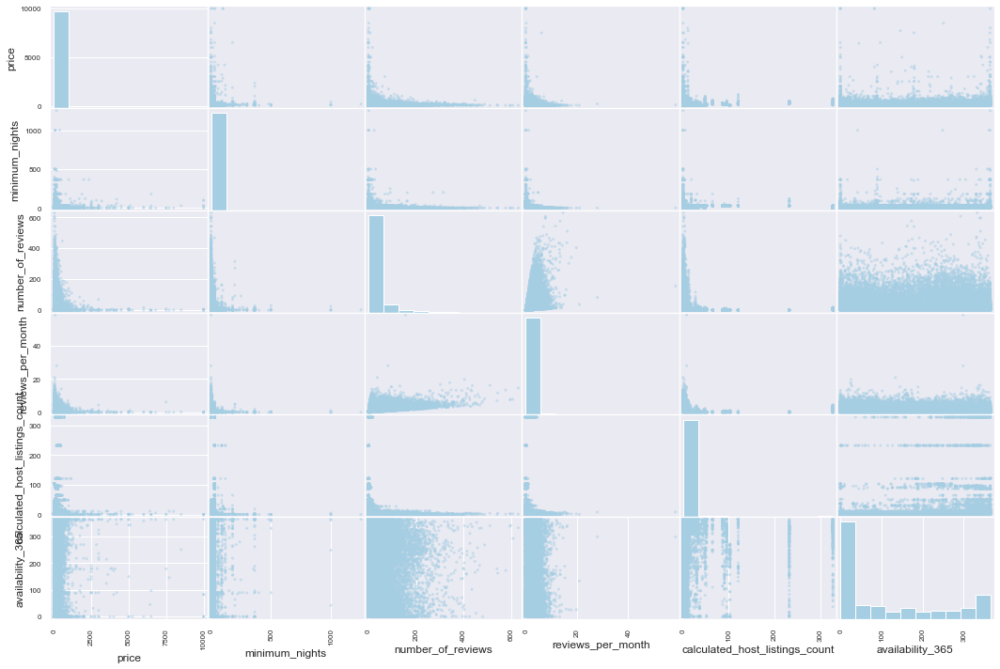

In [193]:
# scatter matrix
from pandas.plotting import scatter_matrix
scatter_matrix(df[numeric_features], figsize=(18, 12))
plt.show()

### Feature Engineering

#What features to encode, aggregate, decompose, scale and transform?
- Transforming the price colmumn (target variable)
- Scaling numerical features 
- Encoding categorical features


#TODO: How good can we do by binning the data? , Decomposing is that right? - 
Now, for the data analysis we are only exploring the data, or should we do the transformation in this homework and store the cleaned dataset. 


- We can decompose the name of the listing to obtain key words that could be used for the prediction.
- We could aggregate some features such as minimum_nights and availability_365 into bins, but this might not be a good idea as we don't know what the best threshold could be and we could lose some information. Many machine learning algorithms will do the aggregation for us, so it is better to leave it in a granular form. 


In [194]:
from sklearn.preprocessing import StandardScaler

In [195]:
#Scaling numerical features
scaler = StandardScaler()
df_new[numeric_features] = scaler.fit_transform(df_new[numeric_features])

In [196]:
# Transforming the target variable
df_new['price'] = price_data_log
fig = px.box(df, y='price', points='all', hover_data=['price'], color='neighbourhood_group')
fig.show()

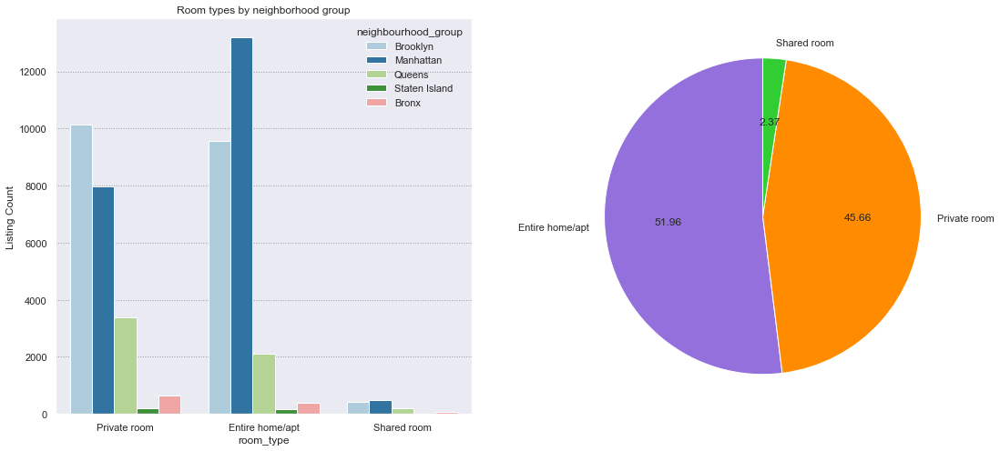

In [197]:
sns.set_style("darkgrid", {"grid.color": ".6", "grid.linestyle": ":"})
f,ax=plt.subplots(1,2,figsize=(18,8))
colors = ['mediumpurple','darkorange','limegreen']
df_new['room_type'].value_counts().plot(kind = 'pie', ax=ax[1],startangle=90,  label = "", colors=colors,autopct='%.2f')
sns.countplot(x = 'room_type',hue = "neighbourhood_group",data = df_new, ax= ax[0])
ax[0].set_ylabel('Listing Count')
ax[0].set_title('Room types by neighborhood group')
plt.show()

<function matplotlib.pyplot.ioff()>

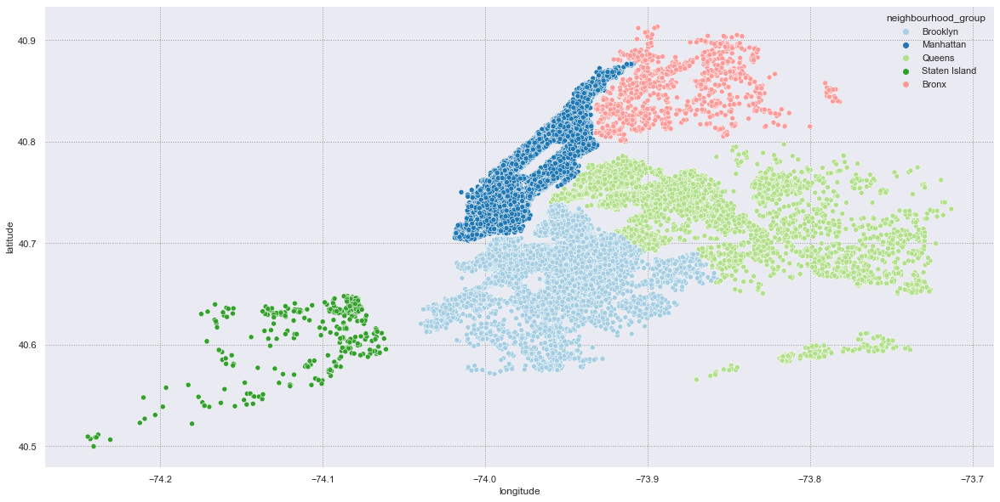

In [200]:
#plotting data
plt.figure(figsize=(20,10))
sns.scatterplot(df_new.longitude, df_new.latitude, hue = df.neighbourhood_group)
plt.ioff

In [138]:
categorical_features

['id', 'name', 'neighbourhood_group', 'neighbourhood', 'room_type']

In [142]:
df_new.neighbourhood.unique().shape

(221,)

Dropping neighbourhood as it has many labels and neighborhood group already considers this attribue. 


In [143]:
df.drop(['neighbourhood'], axis=1, inplace=True)

In [208]:
#feature encoding
df_new = pd.get_dummies(df_new, columns = ['neighbourhood_group'],
                                          prefix = 'NG',drop_first=True)

In [209]:
df_new = pd.get_dummies(df_new, columns = ['room_type'],
                                          drop_first=True)

In [210]:
df.drop(['neighbourhood_group','room_type'], axis=1, inplace=True)

In [211]:
df_new.to_csv('dataset/clean_dataset_airbnb.csv')

## DAU: Data Acquisition and Understanding

1.Data augmentation. Are there additional datasets that you could use to augment the existing set of information contained in your current data in order to improve the accuracy of the QuAM. 

- We can augment the data by importing the number of amenities such as coffee shops, pubs, restaurants, malls and airports that are in a 500 distance radius from the listing.
- We could also augment the data by reviewing the date in which the listing was posted with this price so we can consider time-dependent variables. 

2. Consider your problem definition and what you’ve learned after completing your data analysis & feature engineering. Is an update in problem definition, outcome, action, judgement, context, or ethical concerns needed? (Address each element in this list.)